<a href="https://colab.research.google.com/github/joshlim01/ENPH353_Lab2/blob/main/ENPH_353_Lab_2_Joshua_Lim.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Authorize Google Drive access
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
PATH = "/content/drive/My Drive/ENPH 353/Lab 2"
labels = !ls "{PATH}"
labs = labels[0].split()
print(labels)
raw_video = labs[1]

[' ENPH353_Lab02_Python_CV.ipynb\t raw_video_feed.mp4', "'ENPH 353 Lab 2 - Joshua Lim'"]


In [ ]:
import cv2
import matplotlib.pyplot as plt
import sys
import numpy as np
from google.colab.patches import cv2_imshow

%matplotlib inline

from urllib.request import urlretrieve

source = PATH + '/raw_video_feed.mp4'
cap = cv2.VideoCapture(source)

In [ ]:
if(cap.isOpened() == False):
  print("Error opening video stream or file")

In [ ]:
# Places a circle in the middle of the road on a specific frame
def circle(frame):
  grayScale = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
  radius = 20

  #Threshold to mask
  ret, mask = cv2.threshold(grayScale,70,255,cv2.THRESH_BINARY_INV)
  strip = mask[-radius,:,]

  center_x = center(strip)

  h, w, c = frame.shape
  center_y = h - radius

  image = np.copy(frame)

  cv2.circle(img=image, center = (center_x,center_y), radius = radius, color =(0,0,255), thickness=-1)

  cv2_imshow(image)
  out.write(image)

In [ ]:
# Finds the middle index of the road (used in circle)
def center(strip):
    road = []

    for i in range(len(strip)):
        if(strip[i] == 255):
            road.append(i)

    if len(road) == 0:
        return None
    else:
        road = np.array(road)
        return int(np.mean(road))

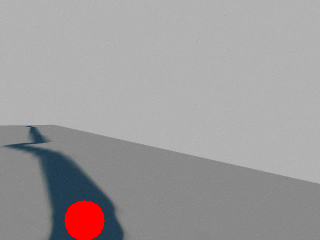

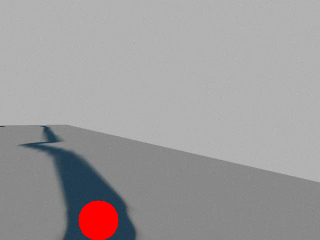

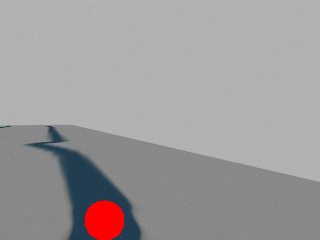

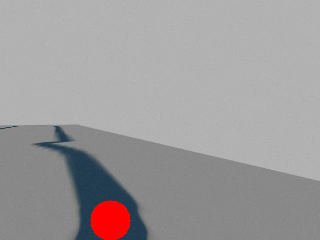

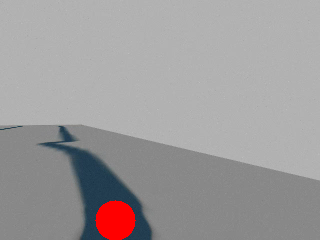

...

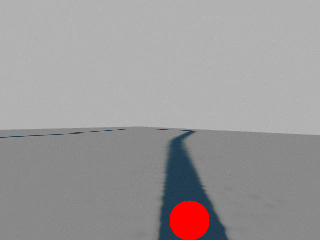

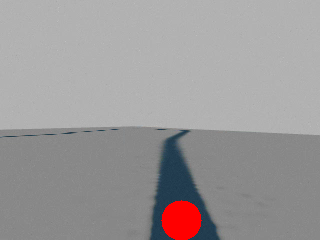

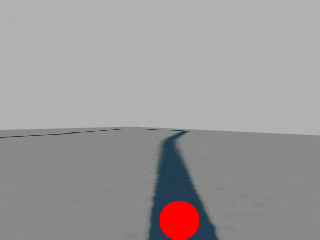

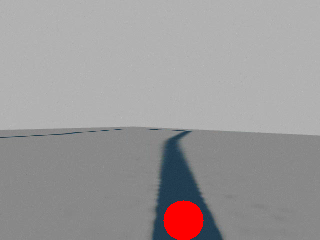

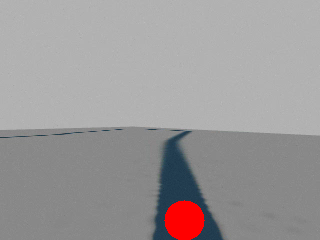

In [ ]:
# Line detection on every frame
ret, frame = cap.read()
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter('labeled_video_feed.mp4', fourcc, 30.0, (int(cap.get(3)), int(cap.get(4))))

while ret == True:
  circle(frame)
  ret, frame = cap.read()
  
out.release()